# Install libraries

In [ ]:
!pip install llama-parse
!pip install graphlit-client
!pip install python-Levenshtein
!pip install matplotlib
!pip install pdf2image

# Load libraries

In [88]:
import os
import time
import nest_asyncio
nest_asyncio.apply()
from llama_parse import LlamaParse
from graphlit_client import Graphlit
from Levenshtein import ratio
from IPython.display import display, HTML
import base64
from pdf2image import convert_from_path
from io import BytesIO
from PIL import Image


# Set and download and a sample file

In [64]:
file_uri="https://www.princexml.com/samples/catalog/PrinceCatalogue.pdf"
file_path="./PrinceCatalogue.pdf"

In [44]:
# Configurations
UNSTRUCTED_API_URL="https://XXXXX.api.unstructuredapp.io/general/v0/general"
UNSTRUCTED_API_KEY="PxXXXX"
GRAPHLIT_ENV_ID="6XXXX"
GRAPHLIT_ORG_ID="fXXXX"
GRAPHLIT_SECRET_KEY="srXXXX"
LLAMA_PARSE_KEY="llx-XXXXX"

# Load with UnstructedAPI

In [45]:
import requests

url = UNSTRUCTED_API_URL

def unstructured_api_request(file_path):
  payload = {'strategy': 'hi_res', 'pdf_infer_table_structure': 'true'}
  files=[
    ('files',(file_path,open(file_path,'rb'),'application/pdf'))
  ]
  headers = {
    'accept': 'application/json',
    'unstructured-api-key': UNSTRUCTED_API_KEY
  }

  response = requests.request("POST", url, headers=headers, data=payload, files=files)
  unstructured_api_result = response.json()

  f = open(f"{file_path}_unstruct_result.txt", "a")
  for data in unstructured_api_result:
    f.write(f"{data['text']}\n")
  f.close()

unstructured_api_request(file_path)

# Load with Graphlit

In [57]:
def create_workflow():
    # Define the GraphQL mutation
    mutation = """
    mutation CreateWorkflow($workflow: WorkflowInput!) {
        createWorkflow(workflow: $workflow) {
            id
        }
    }
    """

    # Define the variables for the mutation
    variables = {
        "workflow": {
            "preparation": {
                "jobs": [
                    {
                    "connector": {
                        "type": "AZURE_DOCUMENT_INTELLIGENCE",
                        "azureDocument": {
                            "model": "LAYOUT"
                        }
                    }
                    }
                ]
            },
            "name": "Azure AI Document Intelligence"
        }
    }

    # Convert the request to JSON format
    response = client.request(query=mutation, variables=variables)

    if 'errors' in response and len(response['errors']) > 0:
        error_message = response['errors'][0]['message']
        return error_message

    return response['data']['createWorkflow']['id']

def delete_workflow(workflow_id):
    # Define the GraphQL mutation
    query = """
    mutation DeleteWorkflow($id: ID!) {
        deleteWorkflow(id: $id) {
            id
        }
        }
    """

    # Define the variables for the mutation
    variables = {
        "id": workflow_id
    }
    response = client.request(query=query, variables=variables)
    return response

def ingest_page(uri, workflow_id):
    # Define the GraphQL mutation
    mutation = """
    mutation IngestPage($uri: URL!, $workflow: EntityReferenceInput, $isSynchronous: Boolean) {
        ingestPage(uri: $uri, workflow: $workflow, isSynchronous: $isSynchronous) {
            id
            markdown
            document {
                title
                keywords
                author
                pageCount
            }
        }
    }
    """

    # Define the variables for the mutation
    variables = {
        "isSynchronous": True, # wait for content to be ingested
        "uri": uri,
        "workflow": {
            "id": workflow_id
        }
    }
    # Convert the request to JSON format
    response = client.request(query=mutation, variables=variables)
    print(response)
    if 'errors' in response and len(response['errors']) > 0:
        error_message = response['errors'][0]['message']
        return error_message

    content_data = response['data']['ingestPage']['markdown']

    return content_data


def ingest_file(uri, workflow_id):
    # Define the GraphQL mutation
    mutation = """
    mutation IngestFile($uri: URL!, $workflow: EntityReferenceInput, $isSynchronous: Boolean) {
        ingestFile(uri: $uri, workflow: $workflow, isSynchronous: $isSynchronous) {
            id
            markdown
            document {
                title
                keywords
                author
                pageCount
            }
        }
    }
    """

    # Define the variables for the mutation
    variables = {
        "isSynchronous": True, # wait for content to be ingested
        "uri": uri,
        "workflow": {
            "id": workflow_id
        }
    }
    # Convert the request to JSON format
    response = client.request(query=mutation, variables=variables)
    print(response)
    if 'errors' in response and len(response['errors']) > 0:
        error_message = response['errors'][0]['message']
        return error_message

    content_data = response['data']['ingestFile']['markdown']

    return content_data

client = Graphlit(environment_id=GRAPHLIT_ENV_ID,
                organization_id=GRAPHLIT_ORG_ID,
                secret_key=GRAPHLIT_SECRET_KEY)
graphlit_result_id = ingest_file(file_uri)
f = open(f"{file_path}_graphlit_result.txt", "w")
f.write(graphlit_result_id)
f.close()

# Load with LLama Parse

In [60]:
def llama_doc_parse(fileloc):
  parser = LlamaParse(
    api_key=LLAMA_PARSE_KEY,  # can also be set in your env as LLAMA_CLOUD_API_KEY
    result_type="text",  # "markdown" and "text" are available
    num_workers=4, # if multiple files passed, split in `num_workers` API calls
    verbose=True,
    language="en" # Optionaly you can define a language, default=en
  )
  # sync
  documents = parser.load_data(fileloc)
  return documents

llama_doc_parse_result = llama_doc_parse(file_path)
f = open(f"{file_path}_llama_result.txt", "w")
f.write(llama_doc_parse_result[0].text)
f.close()

# File Sample Compare

In [95]:
# Convert the first page image to a format that can be displayed in HTML
def img_to_base64(img):
    buffered = BytesIO()
    img.save(buffered, format="JPEG")
    img_str = base64.b64encode(buffered.getvalue()).decode("utf-8")
    return f"data:image/jpeg;base64,{img_str}"

# Function to read and return the content of a text file
def read_text_file(file_path):
    with open(file_path, 'r') as file:
        return file.read()
    
def compare_pdf_extraction(pdf_file, txt_file, title):
    # Step 1: Convert PDF to images
    # Make sure to replace 'path_to_your_pdf.pdf' with the actual path to your PDF file.
    pages = convert_from_path(pdf_file, 300)  # Adjust the DPI as needed

    # Step 2: Calculate the total height and the maximum width of all images combined
    total_height = sum(page.height for page in pages)
    max_width = max(page.width for page in pages)

    # Create a new, blank image that will contain all the pages
    combined_image = Image.new('RGB', (max_width, total_height))

    # Step 3: Paste each page into this blank image
    current_height = 0
    for page in pages:
        # Convert the PIL image to RGB (if not already in RGB, to avoid mode errors)
        rgb_page = page.convert('RGB')
        
        combined_image.paste(rgb_page, (0, current_height))
        current_height += rgb_page.height

        # Read the content of your text file
        text_content = read_text_file(txt_file)

    # Get the base64 string for the first page image
    img_base64 = img_to_base64(combined_image)

    # Create HTML layout for displaying the text and the image side by side
    html_content = f"""
    <h2>{title}</h2>
    <div style="display: flex; width: 100%; align-items: flex-start;">
        <div style="flex: 1; max-width: 50%;">
            <img src="{img_base64}" style="max-width: 100%; height: auto;">
        </div>      
        <div style="flex: 1; margin-right: 20px; max-width: 50%; overflow: auto; white-space: pre-wrap;">
            {text_content}
        </div>
    </div>
    """

    # Display the combined HTML
    display(HTML(html_content))


In [112]:
from difflib import SequenceMatcher
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from tabulate import tabulate
import numpy as np

def read_file(file_path):
    """Reads a file and returns its content."""
    with open(file_path, 'r', encoding='utf-8') as file:
        return file.read()

def calculate_jaccard_similarity(set1, set2):
    """Calculates the Jaccard similarity between two sets."""
    intersection = len(set1.intersection(set2))
    union = len(set1.union(set2))
    return intersection / union

def text_to_set(text):
    """Converts text to a set of words."""
    return set(text.split())

def calculate_cosine_similarity(docs):
    """Calculates cosine similarity between documents using TF-IDF."""
    tfidf_vectorizer = TfidfVectorizer()
    tfidf_matrix = tfidf_vectorizer.fit_transform(docs)
    return cosine_similarity(tfidf_matrix, tfidf_matrix)

def compare_ocr_results(docs):
    """
    Takes a dictionary of document names and their paths, calculates adjusted character counts
    (excluding whitespaces), word counts, Jaccard similarity, cosine similarity, and SequenceMatcher
    similarity between each pair of files, and prints separate tables for character & word counts
    and all similarity metrics.
    
    :param docs: A dictionary where keys are document names and values are paths to the OCR result files.
    """
    # Load OCR results
    ocr_texts = {name: read_file(path) for name, path in docs.items()}
    doc_names = list(docs.keys())
    ocr_content_list = [text for _, text in ocr_texts.items()]
    
    # Character counts (excluding whitespaces) and word counts
    char_and_word_counts = [[name, len(text.replace(" ", "")), len(text.split())] for name, text in ocr_texts.items()]
    
    # Prepare the combined similarity data
    combined_similarity_data = []
    cosine_sim_matrix = calculate_cosine_similarity(ocr_content_list)
    
    for i in range(len(doc_names)):
        for j in range(i + 1, len(doc_names)):
            set1 = text_to_set(ocr_content_list[i])
            set2 = text_to_set(ocr_content_list[j])
            jaccard_score = calculate_jaccard_similarity(set1, set2)
            cosine_score = cosine_sim_matrix[i, j]
            sequence_score = SequenceMatcher(None, ocr_content_list[i], ocr_content_list[j]).ratio()
            combined_similarity_data.append([
                doc_names[i], doc_names[j],
                f"{jaccard_score:.2%}", 
                f"{cosine_score:.2%}", 
                f"{sequence_score:.2%}"
            ])
    
    # Display the character and word counts table
    print("Character and Word Counts:")
    char_word_headers = ['Document', 'Character Count (no spaces)', 'Word Count']
    print(tabulate(char_and_word_counts, headers=char_word_headers, tablefmt="grid"))

    # Display the combined similarity scores table
    print("\nDocument Similarity Scores:")
    similarity_headers = ['Document 1', 'Document 2', 'Jaccard Similarity', 'Cosine Similarity', 'SequenceMatcher Similarity']
    print(tabulate(combined_similarity_data, headers=similarity_headers, tablefmt="grid"))

# Comparing Sample Catalouge
- https://www.princexml.com/samples/catalog/PrinceCatalogue.pdf


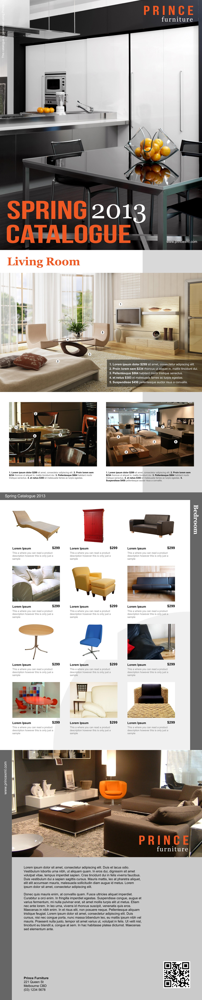


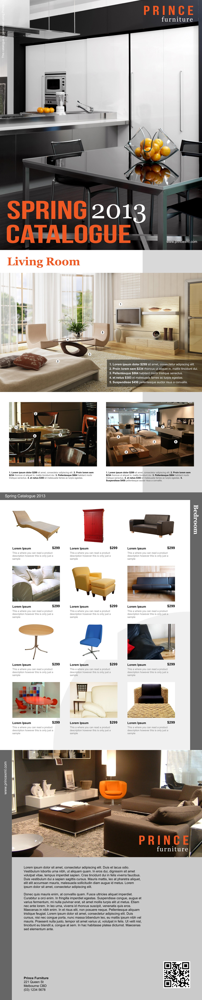


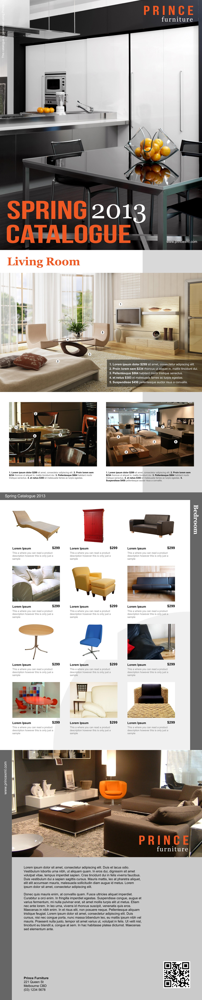

In [96]:
file=1
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

In [113]:
# Example usage
file=1
docs = {
    'Unstructed': f'./Data/{file}/unstruct_result.txt',
    'LlamaParse': f'./Data/{file}/llama_result.txt',
    'Graphlit': f'./Data/{file}/graphlit_result.txt',
}
compare_ocr_results(docs)

Character and Word Counts:
+------------+-------------------------------+--------------+
| Document   |   Character Count (no spaces) |   Word Count |
+============+===============================+==============+
| Unstructed |                          2958 |          670 |
+------------+-------------------------------+--------------+
| LlamaParse |                          2948 |          577 |
+------------+-------------------------------+--------------+
| Graphlit   |                          3068 |          594 |
+------------+-------------------------------+--------------+

Document Similarity Scores:
+--------------+--------------+----------------------+---------------------+------------------------------+
| Document 1   | Document 2   | Jaccard Similarity   | Cosine Similarity   | SequenceMatcher Similarity   |
+==============+==============+======================+=====================+==============================+
| Unstructed   | LlamaParse   | 71.32%               | 98.86% 

# Manual Inspection
- Unstructured was able to extract most of the text from the borchure. There were some text which were missed ex. ("This catalogue is generated using Prince"). Also it output some random characters which were not present in the pdf. Also formatting was little off 
- LlamaParse gave extracted text in good format and was able to detect most of the text in the pdf.
- Graphlit was able to extract the ocr letters in the circle and most of the text mentioned in the pdf.

# Sample research paper
- https://css4.pub/2015/usenix/example.pdf


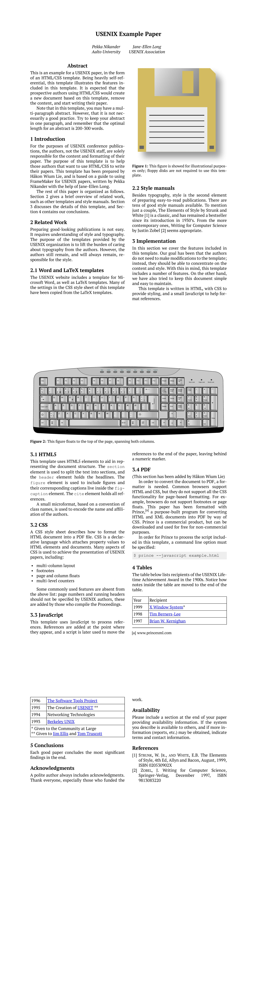


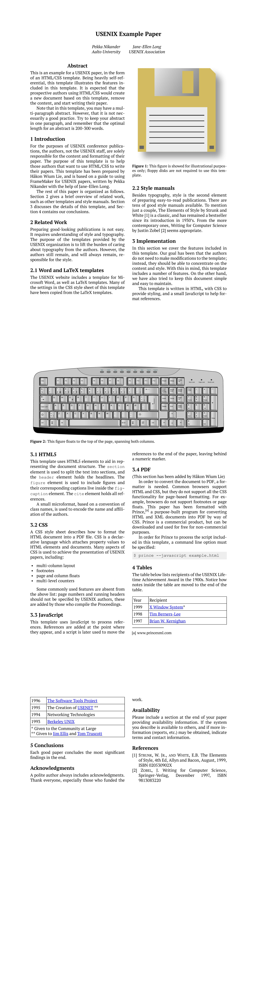


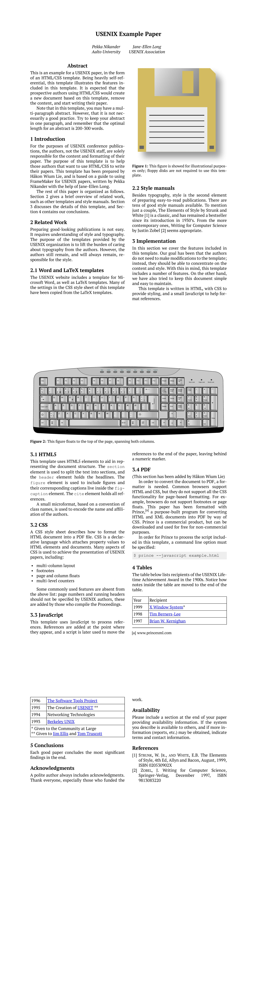

In [97]:
file=2
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

In [114]:
# Example usage
file=2
docs = {
    'Unstructed': f'./Data/{file}/unstruct_result.txt',
    'LlamaParse': f'./Data/{file}/llama_result.txt',
    'Graphlit': f'./Data/{file}/graphlit_result.txt',
}
compare_ocr_results(docs)

Character and Word Counts:
+------------+-------------------------------+--------------+
| Document   |   Character Count (no spaces) |   Word Count |
+============+===============================+==============+
| Unstructed |                          5461 |         1165 |
+------------+-------------------------------+--------------+
| LlamaParse |                          5532 |         1141 |
+------------+-------------------------------+--------------+
| Graphlit   |                          5205 |         1047 |
+------------+-------------------------------+--------------+

Document Similarity Scores:
+--------------+--------------+----------------------+---------------------+------------------------------+
| Document 1   | Document 2   | Jaccard Similarity   | Cosine Similarity   | SequenceMatcher Similarity   |
+==============+==============+======================+=====================+==============================+
| Unstructed   | LlamaParse   | 92.55%               | 99.49% 

# Manual Inspection
- Unstructed and LlamaParse were able to get most of the text even the letters on the keyboard.
- Graphlit was able to get the markdown of the headers.
- Table extraction of LlamaParse was in structured compare to others.

# Sample Invoice document
- https://www.princexml.com/samples/invoice/invoicesample.pdf


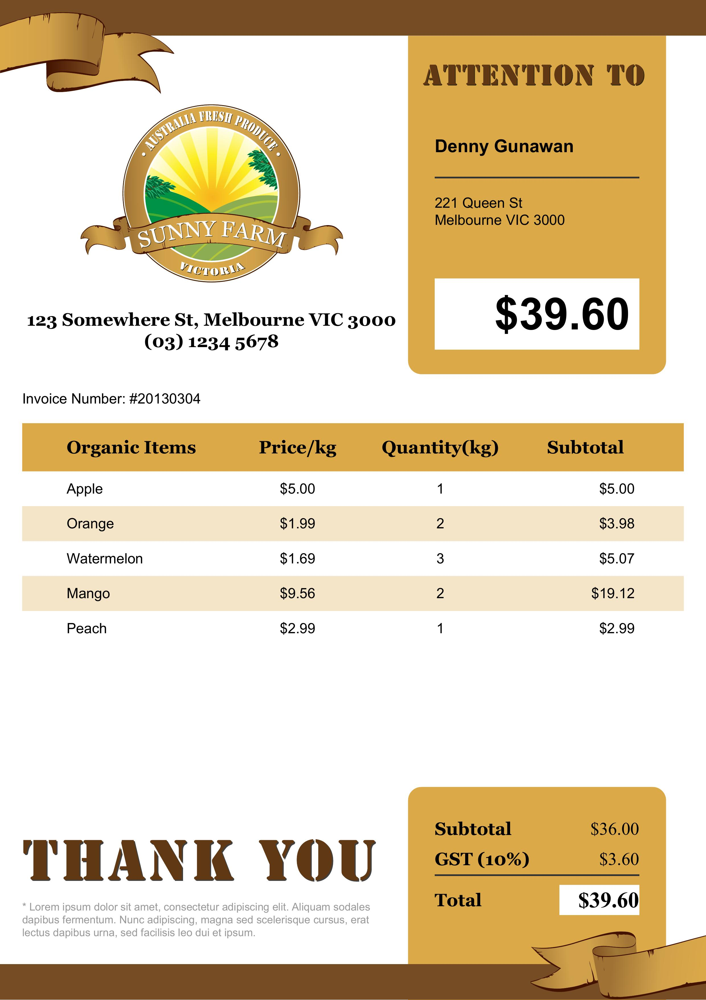


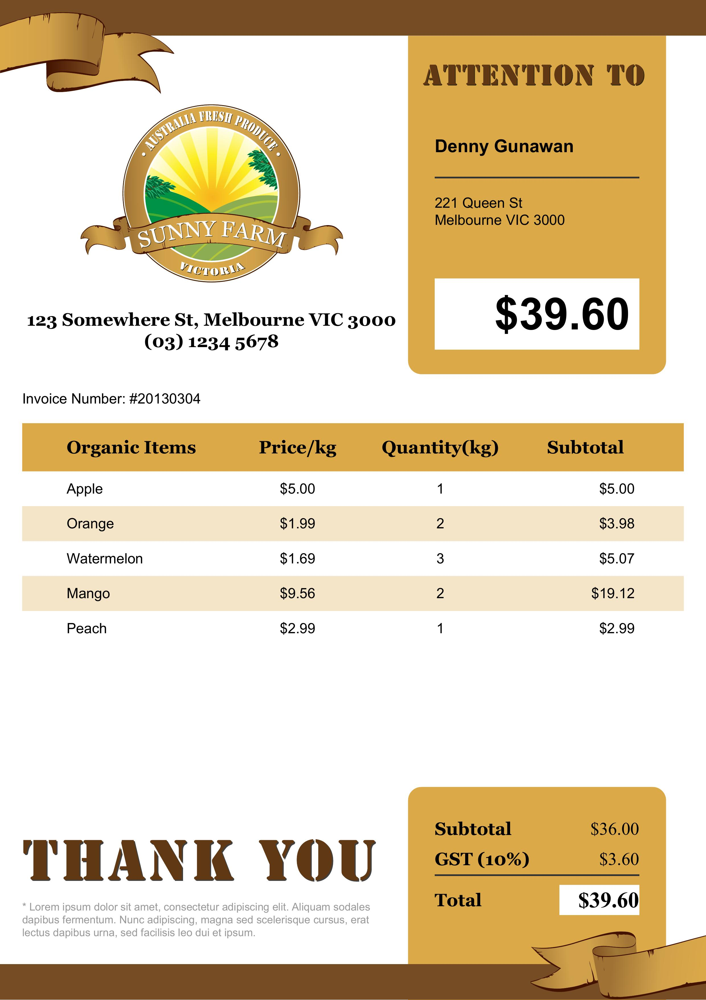


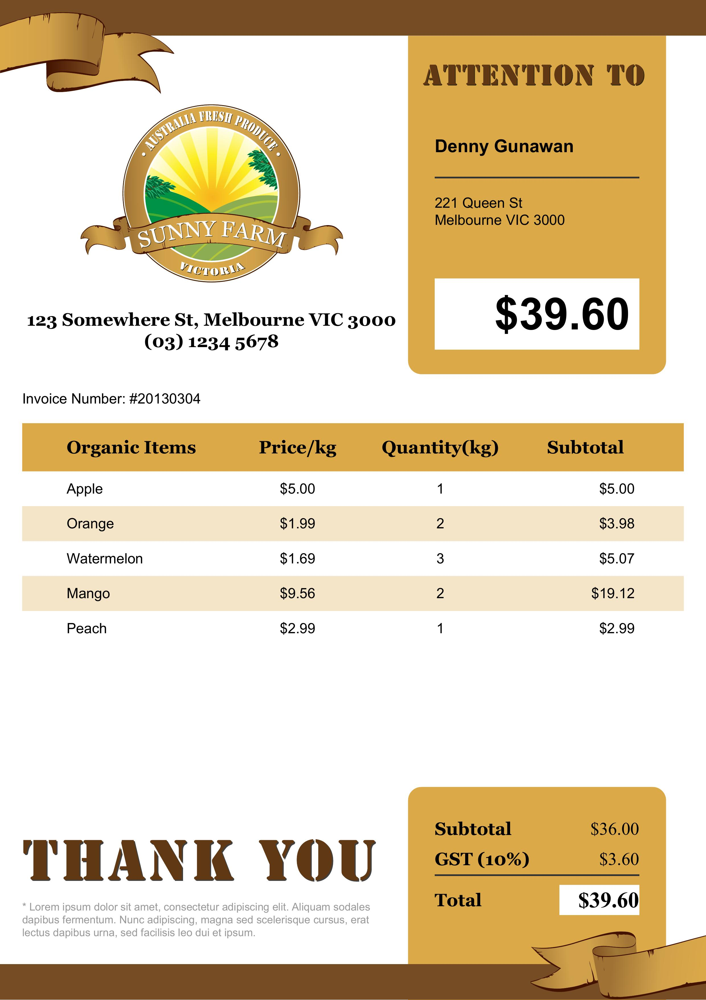

In [98]:
file=3
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

In [115]:
# Example usage
file=3
docs = {
    'Unstructed': f'./Data/{file}/unstruct_result.txt',
    'LlamaParse': f'./Data/{file}/llama_result.txt',
    'Graphlit': f'./Data/{file}/graphlit_result.txt',
}
compare_ocr_results(docs)

Character and Word Counts:
+------------+-------------------------------+--------------+
| Document   |   Character Count (no spaces) |   Word Count |
+============+===============================+==============+
| Unstructed |                           486 |           91 |
+------------+-------------------------------+--------------+
| LlamaParse |                           462 |           82 |
+------------+-------------------------------+--------------+
| Graphlit   |                           565 |          134 |
+------------+-------------------------------+--------------+

Document Similarity Scores:
+--------------+--------------+----------------------+---------------------+------------------------------+
| Document 1   | Document 2   | Jaccard Similarity   | Cosine Similarity   | SequenceMatcher Similarity   |
+==============+==============+======================+=====================+==============================+
| Unstructed   | LlamaParse   | 89.87%               | 96.32% 

# Manual Inspection
- Graphlit printed out some letters which were not mentioned in the document.
- LlamaParse printed in good table formatting

# Sample news article
- https://css4.pub/2017/newsletter/drylab.pdf


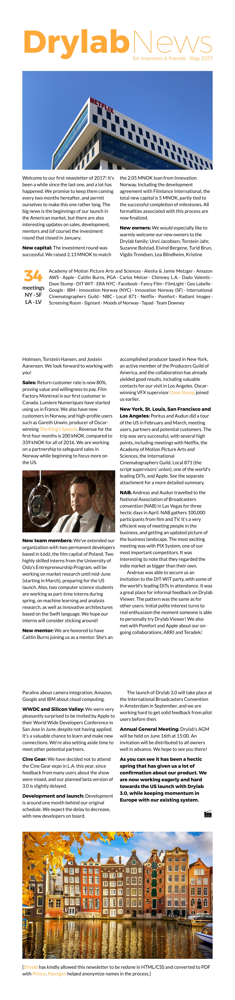


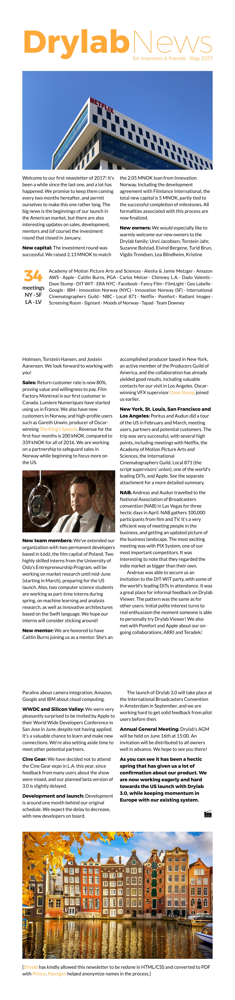


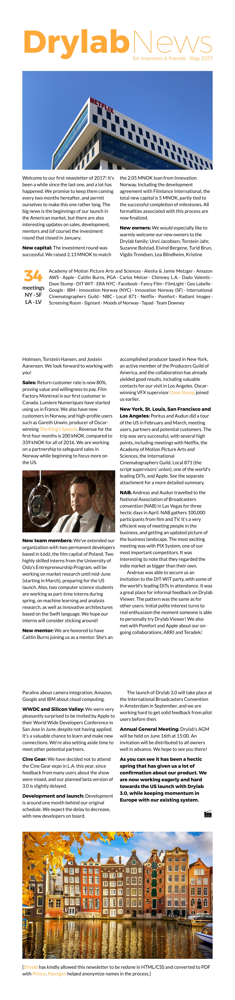

In [99]:
file=4
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

In [116]:
# Example usage
file=4
docs = {
    'Unstructed': f'./Data/{file}/unstruct_result.txt',
    'LlamaParse': f'./Data/{file}/llama_result.txt',
    'Graphlit': f'./Data/{file}/graphlit_result.txt',
}
compare_ocr_results(docs)

Character and Word Counts:
+------------+-------------------------------+--------------+
| Document   |   Character Count (no spaces) |   Word Count |
+============+===============================+==============+
| Unstructed |                          4963 |         1040 |
+------------+-------------------------------+--------------+
| LlamaParse |                          4981 |          987 |
+------------+-------------------------------+--------------+
| Graphlit   |                          4929 |          982 |
+------------+-------------------------------+--------------+

Document Similarity Scores:
+--------------+--------------+----------------------+---------------------+------------------------------+
| Document 1   | Document 2   | Jaccard Similarity   | Cosine Similarity   | SequenceMatcher Similarity   |
+==============+==============+======================+=====================+==============================+
| Unstructed   | LlamaParse   | 90.58%               | 99.66% 

# Manual Inspection
- Unstructed printed out some random characters.
- LlamaParse kept the formating intact with document.
- Graphlit was able to keep the markdown formating. 

# Sample printing document
- https://www.princexml.com/howcome/2016/samples/magic8/index.pdf


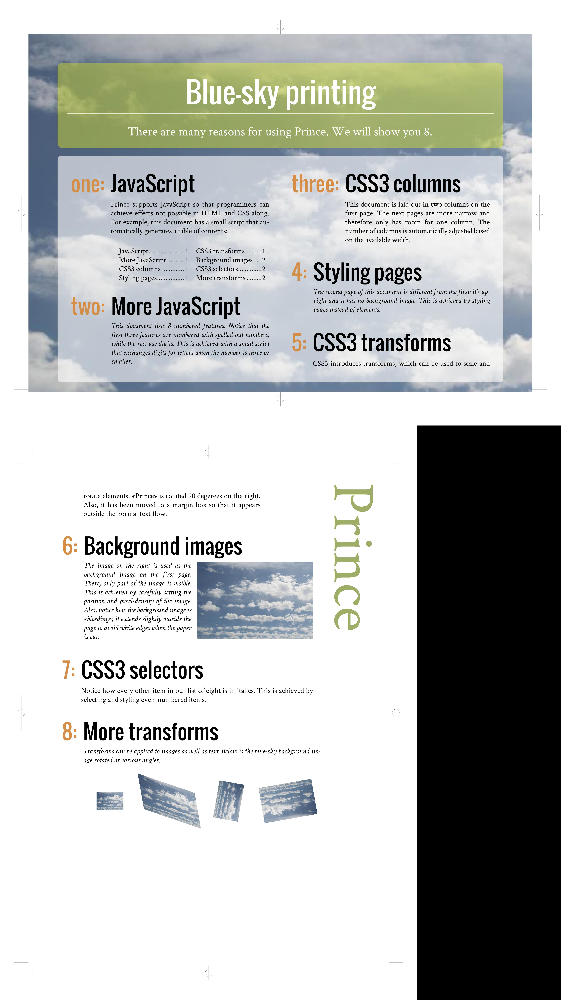


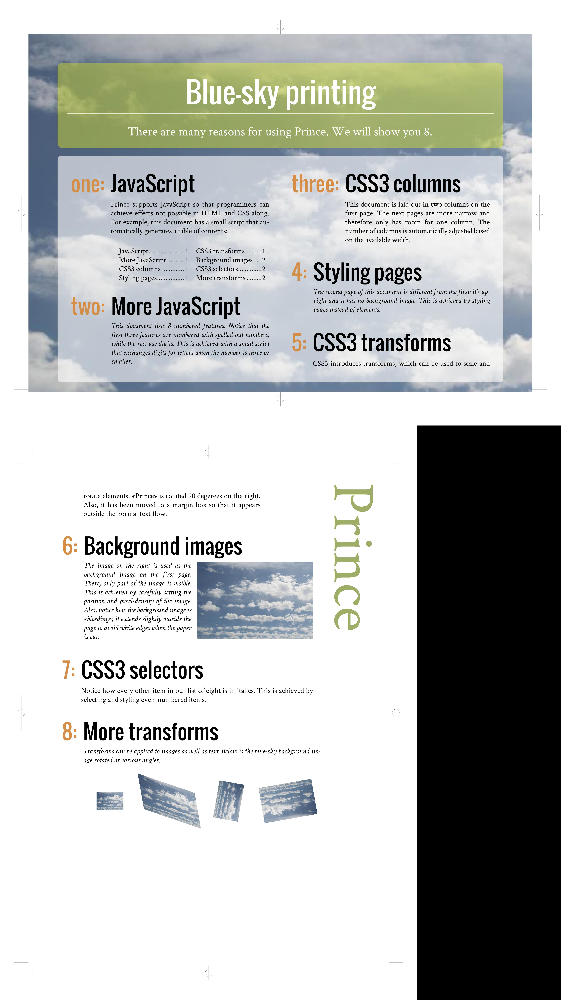


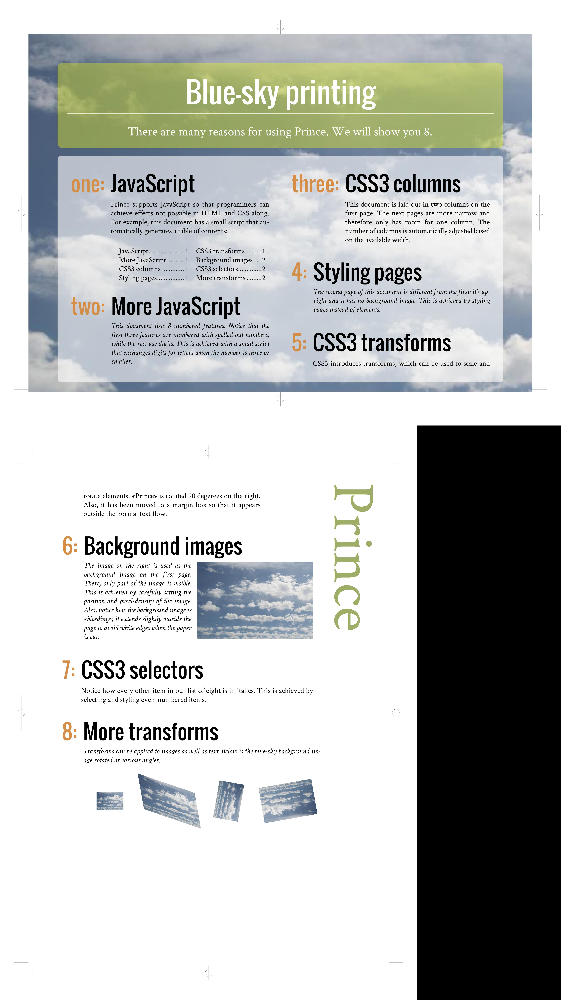

In [100]:
file=5
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

In [117]:
# Example usage
file=5
docs = {
    'Unstructed': f'./Data/{file}/unstruct_result.txt',
    'LlamaParse': f'./Data/{file}/llama_result.txt',
    'Graphlit': f'./Data/{file}/graphlit_result.txt',
}
compare_ocr_results(docs)

Character and Word Counts:
+------------+-------------------------------+--------------+
| Document   |   Character Count (no spaces) |   Word Count |
+============+===============================+==============+
| Unstructed |                          1855 |          390 |
+------------+-------------------------------+--------------+
| LlamaParse |                          1786 |          334 |
+------------+-------------------------------+--------------+
| Graphlit   |                          1756 |          359 |
+------------+-------------------------------+--------------+

Document Similarity Scores:
+--------------+--------------+----------------------+---------------------+------------------------------+
| Document 1   | Document 2   | Jaccard Similarity   | Cosine Similarity   | SequenceMatcher Similarity   |
+==============+==============+======================+=====================+==============================+
| Unstructed   | LlamaParse   | 80.00%               | 98.19% 

# Manual Inspection
- Unstructed gave some random characters and missed to correctetly detect the text
- Graphlit detected multiple 0 which was not there in the document.
- LlamaParse able to output in correct format with detecting the text as much as close to the document.